# **Lab: Week #19 | Solving Optimization Problems with VQE**
---

### **Description**:  
In this week's lab, we will use Qiskit's Variational Quantum Eigensolver (VQE) algorithm to solve several optimization problems.

<br>

### **Learning Objectives**
* Become familiar with the nature of hybrid algorithms.
* See VQE in practice.

---

## **Part 0: Importing from Python Libraries**


---

Run the cell directly below before doing anything else. This will import all of the functions that we will use today.

In [2]:
# Non-qiskit imports
import math
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")


# General Qiskit and VQE imports
from qiskit import Aer, IBMQ
from qiskit import QuantumCircuit
from qiskit.visualization import visualize_transition
from qiskit.algorithms import VQE
from qiskit.circuit.library import EfficientSU2
from qiskit.algorithms.optimizers import SPSA, COBYLA
from qiskit.algorithms import NumPyMinimumEigensolver
from qiskit.utils import QuantumInstance
from qiskit_optimization.algorithms import MinimumEigenOptimizer
from qiskit_optimization.converters import QuadraticProgramToQubo

# Knapsack and Electronic Structure Problem imports
from qiskit_optimization.applications import Knapsack
# as of 02.21.23 - this import is outdated  
# from qiskit_nature.algorithms import (GroundStateEigensolver,
                                     # NumPyMinimumEigensolverFactory)
from qiskit_nature.algorithms.ground_state_solvers import (GroundStateEigensolver,
                                      NumPyMinimumEigensolverFactory)

from qiskit_nature.second_q.algorithms import NumPyMinimumEigensolverFactory
from qiskit_nature.second_q.algorithms import GroundStateEigensolver
from qiskit_nature.drivers import Molecule
from qiskit_nature.drivers import Molecule
from qiskit_nature.drivers.second_quantization import (
    ElectronicStructureMoleculeDriver, ElectronicStructureDriverType)
from qiskit_nature.problems.second_quantization import ElectronicStructureProblem
from qiskit_nature.converters.second_quantization import QubitConverter
from qiskit_nature.mappers.second_quantization import ParityMapper
from qiskit.opflow import TwoQubitReduction


print("Libraries imported successfully!")

Libraries imported successfully!


## **Part 1: Tunable Circuits**
---

In this section, we will see how to make tunable circuits in Qiskit.

### **Exercise #1** 

**Together**, let's create and visualize a 1-qubit circuit with an RX gate with an angle of $\mathbf{\frac{π}{2}}$ (the same as 90°).

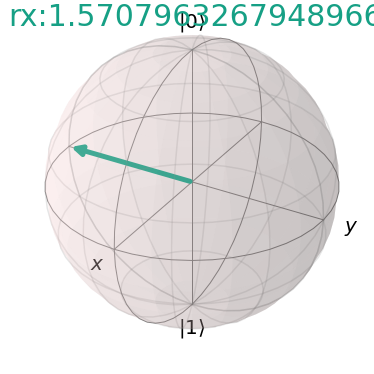

In [6]:
circuit = QuantumCircuit(1)
circuit.rx(math.pi/2,0)

visualize_transition(circuit)

### **Exercise #2** 

**Together**, let's create and visualize a 1-qubit circuit with an X gate and then an RZ gate with an angle of $\mathbf{\frac{π}{4}}$ (the same as 45°).

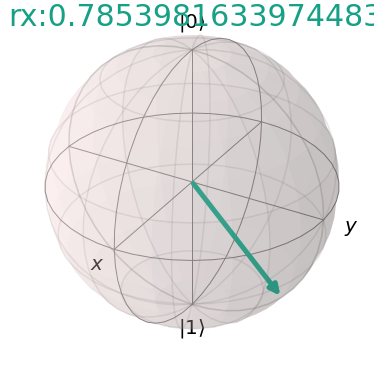

In [7]:
circuit = QuantumCircuit(1)

circuit.x(0)
circuit.rx(math.pi/4,0)

visualize_transition(circuit)

### **Exercise #3** 

**Together**, let's create and visualize the `EfficientSU2` tunable circuit with 1 qubit and 1 repetition.

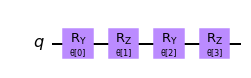

In [9]:
tunable_circuit = EfficientSU2(num_qubits = 1, reps = 1)

tunable_circuit.decompose().draw()

### **Exercise #4** 

**Independently**, create and visualize an `EfficientSU2` tunable circuit with 3 qubits.

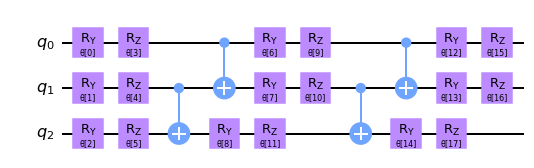

In [10]:
tunable_circuit = EfficientSU2(num_qubits = 3, reps = 2)

tunable_circuit.decompose().draw()

## **Part 2: Solving the Knapsack Problem**
---

In this section, we will use the tunable circuits we saw above to solve the knapsack problem using VQE.

### **Exercise #1: Setting Up the Problem** 

**Together**, let's define the knapsack problem using a built-in Qiskit function called `Knapsack`. We will do so by providing this function:
* A list of values.
* A list of weights.
* The maximum weight.

**Run the code below to create this problem and see how many qubits will be needed.**

In [11]:
values = [4, 2, 5, 10]
weights = [3, 1, 2, 6]
max_weight = 10

knapsack_problem = Knapsack(values = values, weights = weights, max_weight = max_weight)
operator, offset = QuadraticProgramToQubo().convert(knapsack_problem.to_quadratic_program()).to_ising()

print("number of qubits =", operator.num_qubits)

number of qubits = 8


### **Exercise #2: Setting Up VQE**

Next, we will set up VQE. Specifically, we will create:
* The tunable circuit using `EfficientSU2` with the correct number of qubits and 3 repetitions.
* A classical optimizer that uses the `SPSA` algorithm provided by Qiskit.
* The VQE solver combining all of these components.

In [12]:
tunable_circuit = EfficientSU2(num_qubits = 8, reps = 3)

optimizer = SPSA(maxiter=15)

method = VQE(ansatz = tunable_circuit, optimizer = optimizer, quantum_instance = Aer.get_backend('qasm_simulator'))

### **Exercise #3: Visualize the Circuit**

Before solving the problem, let's visualize the tunable circuit we will be using.

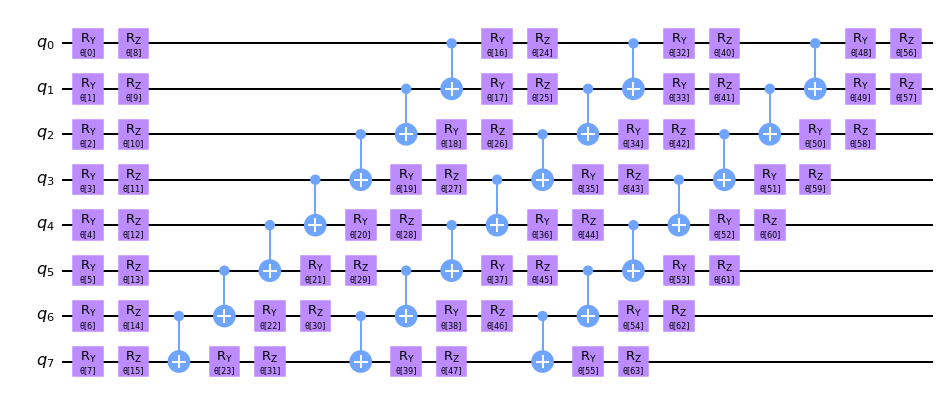

In [13]:
tunable_circuit.decompose().draw()# COMPLETE THIS LINE WITH .draw method

### **Exercise #4: Using VQE to Solve the Problem**

Finally, let's solve the problem using VQE! We have written code in the block below to solve the problem. Don't worry about the code - focus on the results you get. The results will be displayed as follows:

```
result:

 optimal function value: 17.0

optimal value: [0. 1. 1. 1.]

status: SUCCESS

solution:

 [1, 2, 3]
 ```
 
Here, `optimal function value: 17.0` is the optimized value of your knapsack found by VQE. `optimal value: [0. 1. 1. 1.]` shows which items you should put in your knapsack to get this value - 0 means that you should omit this item, and 1 means you should keep it. In this example, you should keep the items with index 1, 2, and 3, and omit the item with index 0 (remember indices begin at 0). This successful solution is also displayed separately as `solution: [1, 2, 3]` .   

Can you verify that VQE solves the knapsack problem correctly?

In [14]:
calc = MinimumEigenOptimizer(method)
result = calc.solve(knapsack_problem.to_quadratic_program())

print('result:\n', result)
print('\nsolution:\n', knapsack_problem.interpret(result))

result:
 fval=17.0, x_0=0.0, x_1=1.0, x_2=1.0, x_3=1.0, status=SUCCESS

solution:
 [1, 2, 3]


### **Followup Activities**

1. Can you simplify the tunable circuit and still get the right result? Try reducing the number of repetitions and the level of entanglement in the tunable circuit. Do you still get the right answer?
2. Try changing the parameters (values, weights, max_weight). Does VQE still give you the optimal knapsack?

## **Part 3: Finding the Structure of a Molecule**
---

In this section, we will use VQE to determine the structure of the hydrogen molecule $H_2$.

### **Exercise #1: Setting Up the Problem** 

**Together**, let's define the problem of finding the electronic structure of $H_2$ with a distance of 0.8 Angstroms between the atoms.

Note: this cell will update as of 02/2023. Refer to your TA to double check your code. 

In [15]:
from qiskit_nature.units import DistanceUnit
from qiskit_nature.second_q.drivers import PySCFDriver

driver = PySCFDriver(
    atom="H 0 0 0; H 0 0 0.735",
    basis="sto3g",
    charge=0,
    spin=0,
    unit=DistanceUnit.ANGSTROM,)


problem = driver.run()

print(problem)

In [16]:

#### MORE INFO DEFINING OUR ELECTRONIC STRUCTURE #######
#run this code 

second_q_ops = problem.second_q_ops()  # Get 2nd Quant OP
num_spin_orbitals = problem.num_spin_orbitals
num_particles = problem.num_particles

mapper = ParityMapper()  # Set Mapper

#this is the energy of our system
hamiltonian = problem.hamiltonian

coefficients = hamiltonian.electronic_integrals
print(coefficients.alpha)

problem.num_particles
problem.num_spatial_orbitals
problem.properties


Polynomial Tensor
 "+-":
[[-1.25633907e+00 -6.21867875e-17]
 [-7.78036432e-17 -4.71896007e-01]]
 "++--":
[[[[6.75710155e-01 1.12401641e-16]
   [1.56722377e-16 1.80931200e-01]]

  [[1.92605510e-16 1.80931200e-01]
   [6.64581730e-01 2.59298923e-16]]]


 [[[8.68926823e-17 6.64581730e-01]
   [1.80931200e-01 1.82411770e-16]]

  [[1.80931200e-01 2.57172666e-16]
   [7.20426423e-17 6.98573723e-01]]]]


### **Exercise #2: Setting Up VQE**

Next, we will set up VQE. Specifically, we will create:
* The tunable circuit using `EfficientSU2` with the correct number of qubits and 1 repetition.
* A classical optimizer that uses the `COBYLA` algorithm provided by Qiskit.
* The VQE solver combining all of these components.

In [17]:
## SET num_qubit to 2 and reps to 1 

tunable_circuit = EfficientSU2(num_qubits = 2, reps = 1) # COMPLETE THIS LINE

optimizer = COBYLA(maxiter=500)

method = VQE(ansatz = tunable_circuit, optimizer = optimizer, quantum_instance = Aer.get_backend('qasm_simulator'))

### **Exercise #3: Visualize the Circuit**

Before solving the problem, let's visualize the tunable circuit we will be using.

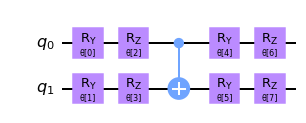

In [18]:
tunable_circuit.decompose().draw()# COMPLETE THIS LINE using .draw method

### **Exercise #4: Using VQE to Solve the Problem**

Finally, it's time to find the energy of this structure and print the results.

In [19]:
#run this code 

from qiskit_nature.second_q.algorithms import GroundStateEigensolver, NumPyMinimumEigensolverFactory
from qiskit_nature.second_q.mappers import JordanWignerMapper, QubitConverter

#Solve for the ground state or lowest cost function 

solver = GroundStateEigensolver(
    QubitConverter(JordanWignerMapper()),
    NumPyMinimumEigensolverFactory(),
)

result = solver.solve(problem)
print("Total energy = ", result.total_energies)

Total energy =  [-1.13730604]


### **Exercise #5: Verify the Solution**

Unlike in Part 2, it's difficult for us to determine if this solution is correct just by looking at it. So, let's use an exact solver that is guaranteed to give us the correct answer.

In [20]:


method = NumPyMinimumEigensolver()

solver = GroundStateEigensolver(
    QubitConverter(JordanWignerMapper()),
    NumPyMinimumEigensolverFactory())

exact_result = solver.solve(problem)
print("Total energy = ", exact_result.total_energies)

Total energy =  [-1.13730604]


**Run the code below to exactly calculate the error in VQE's answer.**

In [21]:
print("Error % = ", (exact_result.total_energies - result.total_energies)/(exact_result.total_energies)*100) 

Error % =  [-2.34284808e-13]


### **Followup Activities**

1. Can you tweak your tunable circuit so that your total energy is closer to the exact solution? Consider looking at the official [EfficientSU2 documentation](https://qiskit.org/documentation/stubs/qiskit.circuit.library.EfficientSU2.html) to see possible ways to tweak the circuit.
2. What is the least number of repetitions that still gives you a good match with the exact solution?
3. What happens when there are more repetitions? Do you notice errors?
4. Change the distance between the atoms in Exercise #1. Can you find the distance that minimizes the total energy?

## CHALLENGE MODE! **Part 4: Finding the Optimal Distance**
---

In the lab, we showed you how we can find the energy for one distance between the hydrogen atoms. Now, let's find the energies for many distances, and in the process, find the lowest possible energy. The distance at which we get the lowest energy corresponds to the ground state bond length of the hydrogen molecule!

In [22]:
tunable_circuit = EfficientSU2(num_qubits = 2, reps = 1, entanglement='full')
optimizer = COBYLA(maxiter=100)
method = VQE(ansatz = tunable_circuit, optimizer = optimizer, quantum_instance = Aer.get_backend('statevector_simulator'))


exact_energies = []
vqe_energies = []
distances = [0.1,0.3,0.5,0.7,0.9,1.1,1.3,1.5,1.7,1.9,2.1,2.3,2.5]




In [25]:

#### CHALLENGE: DEBUG THIS PROGRAM WITH STEPS FROM ABOVE AND EXECUTE VQE DISTANCE FUNCTIONS #####


for i in range(len(distances)):
    
    # Set up the problem for thsi distance
    dist = distances[i]
    molecule = Molecule(
        geometry=[["H", [0.0, 0.0, 0]],
                  ["H", [0.0, 0.0, 0.735]]],
        multiplicity=1,charge=0)

    driver = ElectronicStructureMoleculeDriver(
        molecule=molecule,
        basis="sto3g",
        driver_type=ElectronicStructureDriverType.PYSCF)

    problem = ElectronicStructureProblem(driver)

    second_q_ops = problem.second_q_ops()
    num_spin_orbitals = problem.num_spin_orbitals
    num_particles = problem.num_particles

    mapper = ParityMapper()
    hamiltonian = second_q_ops['ElectronicEnergy']

    converter = QubitConverter(mapper,two_qubit_reduction=True)
    reducer = TwoQubitReduction(num_particles)
    qubit_op = converter.convert(hamiltonian)
    qubit_op = reducer.convert(qubit_op)

    
    # Solve exactly
    method = NumPyMinimumEigensolver()
    exact_calc = GroundStateEigensolver(converter, method)
    exact_result = exact_calc.solve(problem)
    exact_energies.append(result.total_energies)
    
    # Solve with VQE
    vqe_calc = GroundStateEigensolver(converter, method)
    vqe_result = vqe_calc.solve(problem)
    vqe_energies.append(vqe_result.total_energies)
    
    
    print("Completed", i+1, "out of", str(len(distances)), "calculations")

Traceback (most recent call last):
  Input In [25] in <cell line: 4>
    exact_result = exact_calc.solve(problem)
  File /opt/conda/lib/python3.8/site-packages/qiskit_nature/second_q/algorithms/ground_state_solvers/ground_state_eigensolver.py:76 in solve
    main_operator, aux_ops = self.get_qubit_operators(problem, aux_operators)
  File /opt/conda/lib/python3.8/site-packages/qiskit_nature/second_q/algorithms/ground_state_solvers/ground_state_eigensolver.py:93 in get_qubit_operators
    main_second_q_op, aux_second_q_ops = problem.second_q_ops()
ValueError: too many values to unpack (expected 2)

Use %tb to get the full traceback.


**Run the code below to plot the energy as a function of distance for the Exact Solver and VQE.**

Traceback (most recent call last):
  Input In [26] in <cell line: 1>
    plt.plot(distances, exact_energies, distances, vqe_energies, marker = "o")
  File /opt/conda/lib/python3.8/site-packages/matplotlib/pyplot.py:2757 in plot
    return gca().plot(
  File /opt/conda/lib/python3.8/site-packages/matplotlib/axes/_axes.py:1632 in plot
    lines = [*self._get_lines(*args, data=data, **kwargs)]
  File /opt/conda/lib/python3.8/site-packages/matplotlib/axes/_base.py:312 in __call__
    yield from self._plot_args(this, kwargs)
  File /opt/conda/lib/python3.8/site-packages/matplotlib/axes/_base.py:498 in _plot_args
    raise ValueError(f"x and y must have same first dimension, but "
ValueError: x and y must have same first dimension, but have shapes (13,) and (0,)

Use %tb to get the full traceback.


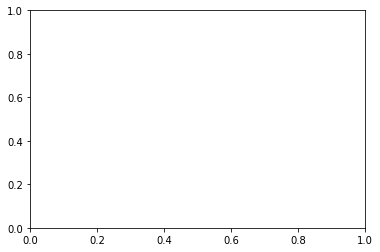

In [26]:
plt.plot(distances, exact_energies, distances, vqe_energies, marker = "o")
plt.xlabel('Distance between atoms (Angstrom)')
plt.ylabel('Energy')
plt.legend(['Exact Solver Energy of the molecule','VQE energy of the molecule'])
plt.show()

# End of Lab
---
© 2023 The Coding School, All rights reserved